In [1]:
! pip install imageio

In [2]:
import os
import numpy as np 
import tensorflow as tf 
import matplotlib.pyplot as plt
from tensorflow import keras 
from keras.models import Sequential 
from keras.layers import Dense, Conv2D, Conv2DTranspose, LeakyReLU, BatchNormalization, Flatten, Dropout, Reshape
from keras.optimizers import Adam
from numpy.random import randn
from numpy.random import randint
import time
# import imagio

2023-10-26 05:16:05.391937: I tensorflow/core/util/port.cc:110] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-10-26 05:16:05.450998: I tensorflow/core/platform/cpu_feature_guard.cc:183] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE3 SSE4.1 SSE4.2 AVX, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [3]:
path = "/work/assignment/a3_gan/dataset_a3/align-cropped/img_align_celeba_png/"
img_height = 64
img_width = 64
batch_size = 32

dataset = keras.utils.image_dataset_from_directory(
    path,
    image_size= (img_height,img_width),
    batch_size=batch_size,
    shuffle= True,
    labels=None
)

Found 202599 files belonging to 1 classes.


2023-10-26 05:16:15.193994: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1636] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 1160 MB memory:  -> device: 0, name: NVIDIA A100-PCIE-40GB, pci bus id: 0000:06:00.0, compute capability: 8.0
2023-10-26 05:16:15.194625: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1636] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 31844 MB memory:  -> device: 1, name: NVIDIA A100-PCIE-40GB, pci bus id: 0000:86:00.0, compute capability: 8.0


In [4]:
images = []
for img in dataset:
    images.append(img.numpy())

# Convert the lists to numpy arrays
images = np.concatenate(images)

images = images[:20000]
images = np.round(images/255.0,4)

In [5]:
def discriminator(in_shape=(64,64,3)):
    model = Sequential()
    # normal
    model.add(Conv2D(128, (5,5), padding='same', input_shape=in_shape))
    model.add(LeakyReLU(alpha=0.2))
    # downsample to 64x64
    model.add(Conv2D(128, (5,5), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    # downsample to 32x32
    model.add(Conv2D(128, (5,5), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    # downsample to 16x16
    model.add(Conv2D(128, (5,5), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    # downsample to 8x8
    model.add(Conv2D(128, (5,5), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    # classifier
    model.add(Flatten())
    model.add(Dropout(0.4))
    model.add(Dense(1, activation='sigmoid'))
    # compile model
    opt = Adam(learning_rate=0.0002, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])
    return model

In [6]:
dis = discriminator()
dis.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 64, 64, 128)       9728      
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 64, 64, 128)       0         
                                                                 
 conv2d_1 (Conv2D)           (None, 32, 32, 128)       409728    
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 32, 32, 128)       0         
                                                                 
 conv2d_2 (Conv2D)           (None, 16, 16, 128)       409728    
                                                                 
 leaky_re_lu_2 (LeakyReLU)   (None, 16, 16, 128)       0         
                                                                 
 conv2d_3 (Conv2D)           (None, 8, 8, 128)         4

In [7]:
def generator(latent_dim):
    model = Sequential()
    # foundation for 8x8 feature maps
    n_nodes = 128 * 8 * 8
    model.add(Dense(n_nodes, input_dim=latent_dim))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Reshape((8, 8, 128)))
    # upsample to 16x16
    model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    # upsample to 32x32
    model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    # upsample to 64x64
    model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    # # upsample to 128x128
    # model.add(Conv2DTranspose(128, (4,4), strides=(2,2), padding='same'))
    # model.add(LeakyReLU(alpha=0.2))
    # # output layer 128x128x3
    model.add(Conv2D(3, (5,5), activation='tanh', padding='same'))
    return model

In [8]:
latent_dim = 100
gen = generator(latent_dim)
gen.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_1 (Dense)             (None, 8192)              827392    
                                                                 
 leaky_re_lu_5 (LeakyReLU)   (None, 8192)              0         
                                                                 
 reshape (Reshape)           (None, 8, 8, 128)         0         
                                                                 
 conv2d_transpose (Conv2DTr  (None, 16, 16, 128)       262272    
 anspose)                                                        
                                                                 
 leaky_re_lu_6 (LeakyReLU)   (None, 16, 16, 128)       0         
                                                                 
 conv2d_transpose_1 (Conv2D  (None, 32, 32, 128)       262272    
 Transpose)                                           

In [9]:
def generate_latent_points(latent_dim, n_samples):
    # generate points in the latent space
    x_input = randn(latent_dim * n_samples)
    # reshape into a batch of inputs for the network
    x_input = x_input.reshape(n_samples, latent_dim)
    return x_input

# use the generator to generate n fake examples, with class labels
def generate_fake_samples(g_model, latent_dim, n_samples):
    # generate points in latent space
    x_input = generate_latent_points(latent_dim, n_samples)
    # predict outputs
    X = g_model.predict(x_input)
    # create 'fake' class labels (0)
    y = np.zeros((n_samples, 1))
    return X, y

In [10]:
def gan(g_model, d_model):
    # make weights in the discriminator not trainable
    d_model.trainable = False
    # connect them
    model = Sequential()
    # add generator
    model.add(g_model)
    # add the discriminator
    model.add(d_model)
    # compile model
    opt = Adam(learning_rate=0.0002, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=opt)
    return model

In [11]:
GAN = gan(gen,dis)
GAN.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_1 (Sequential)   (None, 64, 64, 3)         1623811   
                                                                 
 sequential (Sequential)     (None, 1)                 1650689   
                                                                 
Total params: 3274500 (12.49 MB)
Trainable params: 1623811 (6.19 MB)
Non-trainable params: 1650689 (6.30 MB)
_________________________________________________________________


In [12]:
# retrive real samples
def get_real_samples(dataset, n_samples):
    # choose random instances
    ix = randint(0, dataset.shape[0], n_samples)
    # retrieve selected images
    X = dataset[ix]
    # set 'real' class labels (1)
    y = np.ones((n_samples, 1))
    return X, y

In [13]:
# create and save a plot of generated images
def show_generated(generated,epoch, n=5):
    #[-1,1] -> [0,1] 
    #generated = (generated + 1)/ 2
    #generated = (generated[:n*n] * 127.5) + 127.5
    #generated = generated * 255
    plt.figure(figsize=(10,10))
    for i in range(n * n):
        plt.subplot(n, n, i + 1)
        #img = plt.imread(data_dir + '/' + name)
        plt.imshow(generated[i])
        #plt.title(name)
        plt.axis('off')
    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch+1))
    plt.show()   

In [14]:
# evaluate the discriminator and plot generated images
def summarize_performance(epoch, g_model, d_model, dataset, latent_dim, n_samples=100):
    # prepare real samples
    X_real, y_real = get_real_samples(dataset, n_samples)
    # evaluate discriminator on real examples
    _, acc_real = d_model.evaluate(X_real, y_real, verbose=0)
    # prepare fake examples
    x_fake, y_fake = generate_fake_samples(g_model, latent_dim, n_samples)
    # evaluate discriminator on fake examples
    _, acc_fake = d_model.evaluate(x_fake, y_fake, verbose=0)
    # summarize discriminator performance
    print('>Accuracy [real: %.0f%%, fake: %.0f%%]' % (acc_real*100, acc_fake*100))
    # show plot
    show_generated(x_fake, epoch)   

In [17]:
def train(g_model, d_model, gan_model, dataset, latent_dim=100, n_epochs=100, n_batch=batch_size):
    bat_per_epo = int(dataset.shape[0] / n_batch)
    half_batch = int(n_batch / 2)
    # manually enumerate epochs
    start = time.time()
    for i in range(n_epochs):
        print(f'Epoch: {i+1}/{n_epochs}')
        # enumerate batches over the training set
        for j in range(bat_per_epo):
            # get randomly selected 'real' samples
            X_real, y_real = get_real_samples(dataset, half_batch)
            # update discriminator model weights
            d_loss1, _ = d_model.train_on_batch(X_real, y_real)
            # generate 'fake' examples
            X_fake, y_fake = generate_fake_samples(g_model, latent_dim, half_batch)
            # update discriminator model weights
            d_loss2, _ = d_model.train_on_batch(X_fake, y_fake)
            # prepare points in latent space as input for the generator
            X_gan = generate_latent_points(latent_dim, n_batch)
            # create inverted labels for the fake samples
            y_gan = np.ones((n_batch, 1))
            # update the generator via the discriminator's error
            g_loss = gan_model.train_on_batch(X_gan, y_gan)
            # summarize loss on this batch
        print('Epoch: %d,  Loss: D_real = %.3f, D_fake = %.3f,  G = %.3f' %   (i+1, d_loss1, d_loss2, g_loss))
        # evaluate the model performance
        if (i+1) % 10 == 0:
            summarize_performance(i, g_model, d_model, dataset, latent_dim)     
    print ('Total time for training {} epochs is {} sec'.format(n_epochs, (time.time()-start)))

Epoch: 1/200
1/1 [==============================] - 0s 25ms/step
Epoch: 1,  Loss: D_real = 0.285, D_fake = 0.282,  G = 2.282
Epoch: 2/200
1/1 [==============================] - 0s 28ms/step
Epoch: 2,  Loss: D_real = 0.583, D_fake = 0.535,  G = 1.396
Epoch: 3/200
1/1 [==============================] - 0s 29ms/step
Epoch: 3,  Loss: D_real = 0.249, D_fake = 0.358,  G = 1.751
Epoch: 4/200
1/1 [==============================] - 0s 25ms/step
Epoch: 4,  Loss: D_real = 0.619, D_fake = 0.164,  G = 2.133
Epoch: 5/200
1/1 [==============================] - 0s 34ms/step
Epoch: 5,  Loss: D_real = 0.385, D_fake = 0.396,  G = 1.752
Epoch: 6/200
1/1 [==============================] - 0s 23ms/step
Epoch: 6,  Loss: D_real = 0.577, D_fake = 0.253,  G = 2.033
Epoch: 7/200
1/1 [==============================] - 0s 31ms/step
Epoch: 7,  Loss: D_real = 0.604, D_fake = 0.335,  G = 2.150
Epoch: 8/200
1/1 [==============================] - 0s 26ms/step
Epoch: 8,  Loss: D_real = 0.427, D_fake = 0.191,  G = 2.195


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


>Accuracy [real: 76%, fake: 90%]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

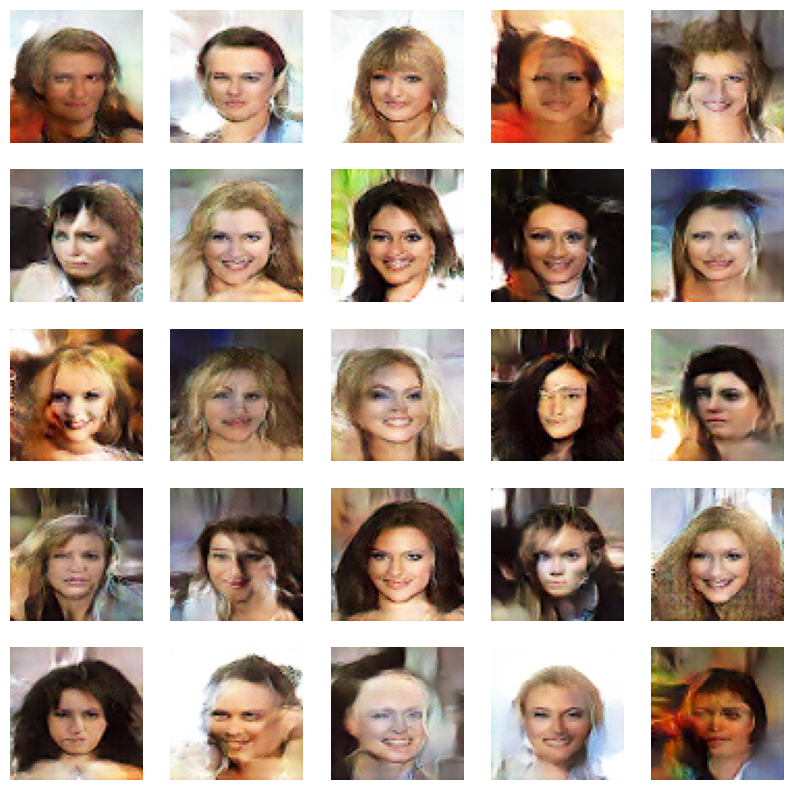

Epoch: 11/200
1/1 [==============================] - 0s 27ms/step
Epoch: 11,  Loss: D_real = 0.219, D_fake = 0.289,  G = 2.323
Epoch: 12/200
1/1 [==============================] - 0s 29ms/step
Epoch: 12,  Loss: D_real = 0.286, D_fake = 0.272,  G = 2.177
Epoch: 13/200
1/1 [==============================] - 0s 26ms/step
Epoch: 13,  Loss: D_real = 0.989, D_fake = 0.489,  G = 2.163
Epoch: 14/200
1/1 [==============================] - 0s 25ms/step
Epoch: 14,  Loss: D_real = 0.609, D_fake = 0.879,  G = 0.907
Epoch: 15/200
1/1 [==============================] - 0s 29ms/step
Epoch: 15,  Loss: D_real = 0.640, D_fake = 0.485,  G = 1.158
Epoch: 16/200
1/1 [==============================] - 0s 27ms/step
Epoch: 16,  Loss: D_real = 0.220, D_fake = 0.597,  G = 1.955
Epoch: 17/200
1/1 [==============================] - 0s 26ms/step
Epoch: 17,  Loss: D_real = 0.674, D_fake = 0.390,  G = 1.935
Epoch: 18/200
1/1 [==============================] - 0s 30ms/step
Epoch: 18,  Loss: D_real = 0.673, D_fake = 0.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


>Accuracy [real: 76%, fake: 79%]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

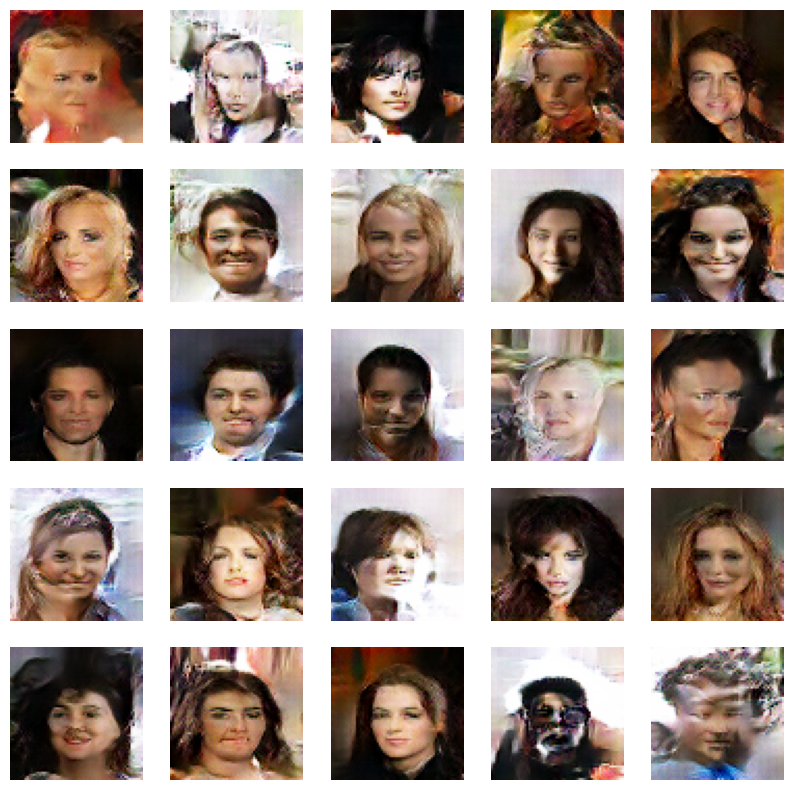

Epoch: 21/200
1/1 [==============================] - 0s 32ms/step
Epoch: 21,  Loss: D_real = 0.210, D_fake = 0.435,  G = 1.855
Epoch: 22/200
1/1 [==============================] - 0s 32ms/step
Epoch: 22,  Loss: D_real = 0.286, D_fake = 0.396,  G = 1.902
Epoch: 23/200
1/1 [==============================] - 0s 25ms/step
Epoch: 23,  Loss: D_real = 0.929, D_fake = 0.379,  G = 1.791
Epoch: 24/200
1/1 [==============================] - 0s 27ms/step
Epoch: 24,  Loss: D_real = 0.546, D_fake = 0.610,  G = 1.638
Epoch: 25/200
1/1 [==============================] - 0s 26ms/step
Epoch: 25,  Loss: D_real = 0.622, D_fake = 0.317,  G = 2.254
Epoch: 26/200
1/1 [==============================] - 0s 32ms/step
Epoch: 26,  Loss: D_real = 0.526, D_fake = 0.451,  G = 2.385
Epoch: 27/200
1/1 [==============================] - 0s 26ms/step
Epoch: 27,  Loss: D_real = 0.427, D_fake = 0.564,  G = 1.245
Epoch: 28/200
1/1 [==============================] - 0s 38ms/step
Epoch: 28,  Loss: D_real = 0.142, D_fake = 0.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


>Accuracy [real: 67%, fake: 97%]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

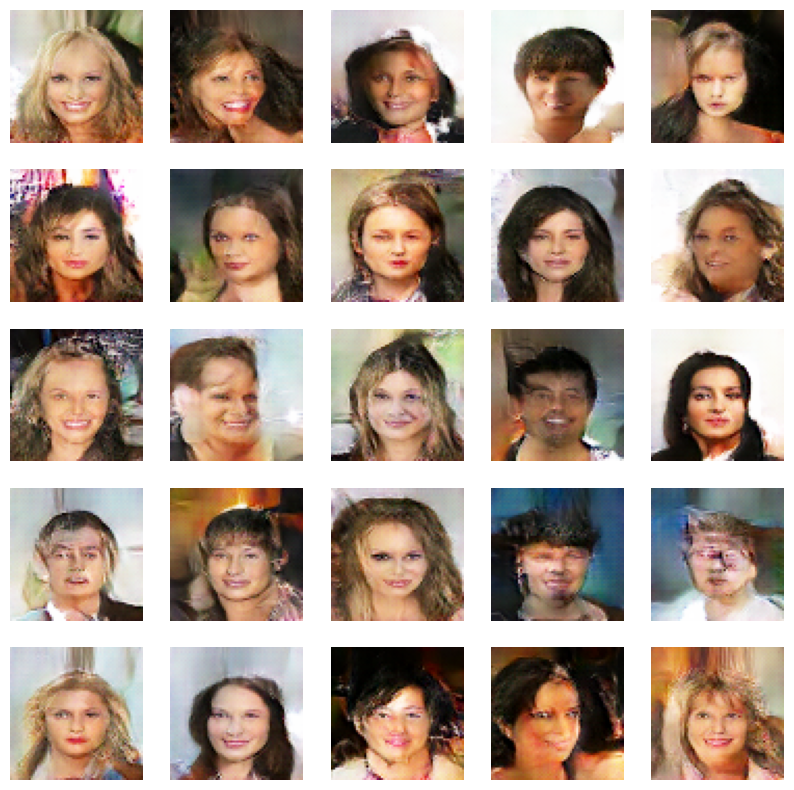

Epoch: 31/200
1/1 [==============================] - 0s 28ms/step
Epoch: 31,  Loss: D_real = 0.239, D_fake = 0.306,  G = 2.371
Epoch: 32/200
1/1 [==============================] - 0s 26ms/step
Epoch: 32,  Loss: D_real = 0.092, D_fake = 0.482,  G = 2.914
Epoch: 33/200
1/1 [==============================] - 0s 26ms/step
Epoch: 33,  Loss: D_real = 0.911, D_fake = 0.621,  G = 1.852
Epoch: 34/200
1/1 [==============================] - 0s 29ms/step
Epoch: 34,  Loss: D_real = 0.478, D_fake = 0.719,  G = 1.315
Epoch: 35/200
1/1 [==============================] - 0s 28ms/step
Epoch: 35,  Loss: D_real = 0.942, D_fake = 0.690,  G = 2.133
Epoch: 36/200
1/1 [==============================] - 0s 28ms/step
Epoch: 36,  Loss: D_real = 0.463, D_fake = 0.243,  G = 2.364
Epoch: 37/200
1/1 [==============================] - 0s 33ms/step
Epoch: 37,  Loss: D_real = 0.861, D_fake = 0.303,  G = 1.960
Epoch: 38/200
1/1 [==============================] - 0s 32ms/step
Epoch: 38,  Loss: D_real = 0.471, D_fake = 0.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


>Accuracy [real: 79%, fake: 94%]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

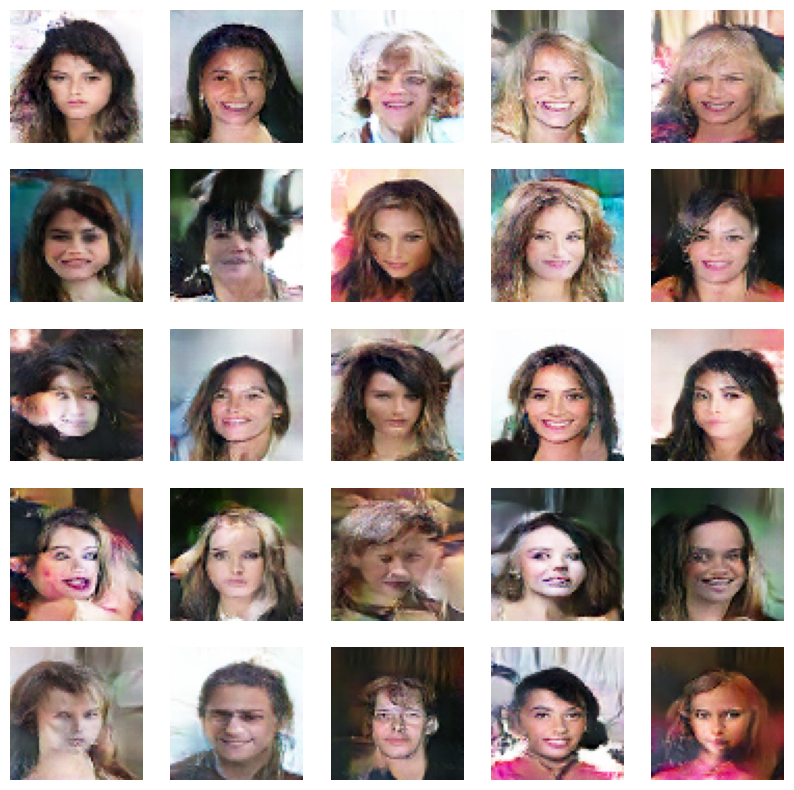

Epoch: 41/200
1/1 [==============================] - 0s 27ms/step
Epoch: 41,  Loss: D_real = 0.379, D_fake = 0.173,  G = 2.324
Epoch: 42/200
1/1 [==============================] - 0s 27ms/step
Epoch: 42,  Loss: D_real = 0.375, D_fake = 0.310,  G = 2.193
Epoch: 43/200
1/1 [==============================] - 0s 28ms/step
Epoch: 43,  Loss: D_real = 0.395, D_fake = 0.297,  G = 2.243
Epoch: 44/200
1/1 [==============================] - 0s 28ms/step
Epoch: 44,  Loss: D_real = 0.430, D_fake = 0.692,  G = 2.476
Epoch: 45/200
1/1 [==============================] - 0s 29ms/step
Epoch: 45,  Loss: D_real = 0.303, D_fake = 0.366,  G = 2.614
Epoch: 46/200
1/1 [==============================] - 0s 37ms/step
Epoch: 46,  Loss: D_real = 0.575, D_fake = 0.284,  G = 2.116
Epoch: 47/200
1/1 [==============================] - 0s 27ms/step
Epoch: 47,  Loss: D_real = 0.169, D_fake = 0.283,  G = 2.454
Epoch: 48/200
1/1 [==============================] - 0s 27ms/step
Epoch: 48,  Loss: D_real = 0.366, D_fake = 0.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


>Accuracy [real: 88%, fake: 92%]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

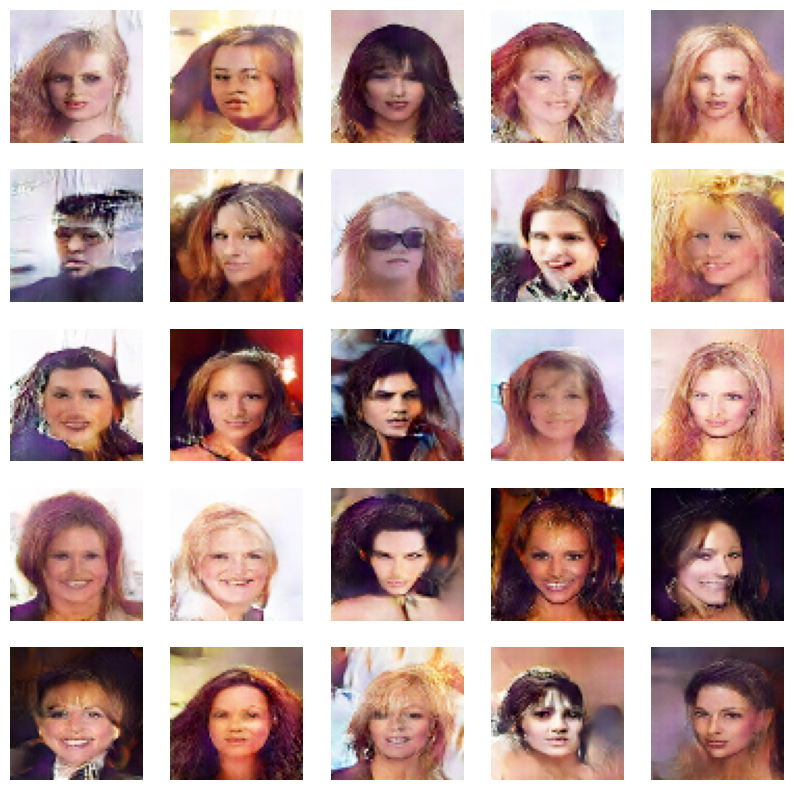

Epoch: 51/200
1/1 [==============================] - 0s 31ms/step
Epoch: 51,  Loss: D_real = 0.537, D_fake = 0.292,  G = 1.832
Epoch: 52/200
1/1 [==============================] - 0s 37ms/step
Epoch: 52,  Loss: D_real = 0.164, D_fake = 0.143,  G = 3.211
Epoch: 53/200
1/1 [==============================] - 0s 35ms/step
Epoch: 53,  Loss: D_real = 0.245, D_fake = 0.088,  G = 2.788
Epoch: 54/200
1/1 [==============================] - 0s 26ms/step
Epoch: 54,  Loss: D_real = 0.129, D_fake = 0.232,  G = 2.239
Epoch: 55/200
1/1 [==============================] - 0s 30ms/step
Epoch: 55,  Loss: D_real = 0.260, D_fake = 0.170,  G = 3.039
Epoch: 56/200
1/1 [==============================] - 0s 29ms/step
Epoch: 56,  Loss: D_real = 0.124, D_fake = 0.117,  G = 2.964
Epoch: 57/200
1/1 [==============================] - 0s 28ms/step
Epoch: 57,  Loss: D_real = 0.621, D_fake = 0.114,  G = 2.336
Epoch: 58/200
1/1 [==============================] - 0s 28ms/step
Epoch: 58,  Loss: D_real = 0.280, D_fake = 0.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


>Accuracy [real: 89%, fake: 95%]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

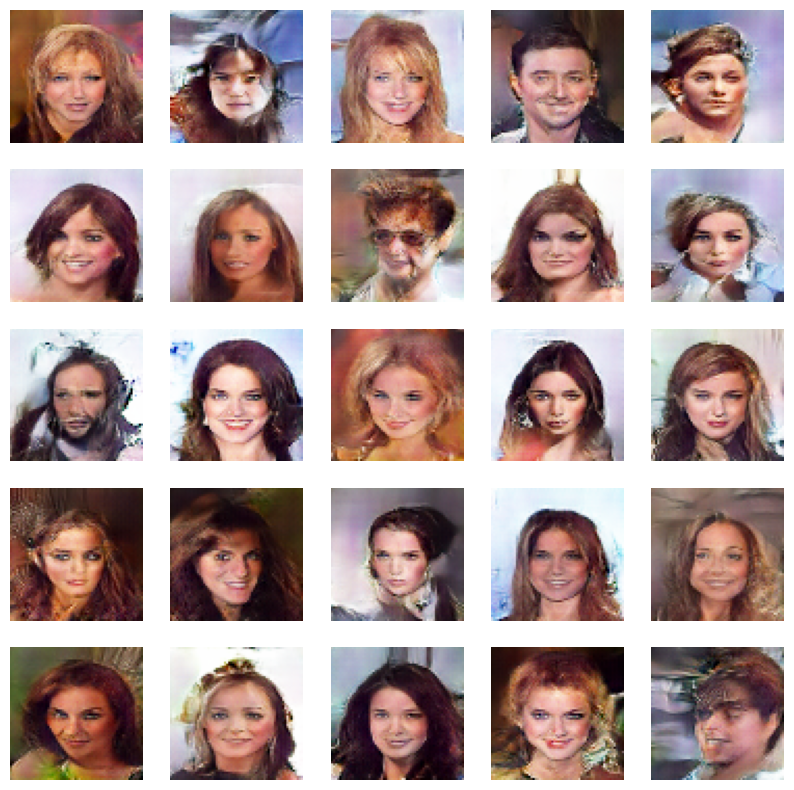

Epoch: 61/200
1/1 [==============================] - 0s 26ms/step
Epoch: 61,  Loss: D_real = 0.513, D_fake = 0.488,  G = 2.514
Epoch: 62/200
1/1 [==============================] - 0s 27ms/step
Epoch: 62,  Loss: D_real = 0.131, D_fake = 0.265,  G = 3.207
Epoch: 63/200
1/1 [==============================] - 0s 39ms/step
Epoch: 63,  Loss: D_real = 0.381, D_fake = 0.248,  G = 2.394
Epoch: 64/200
1/1 [==============================] - 0s 38ms/step
Epoch: 64,  Loss: D_real = 0.178, D_fake = 0.079,  G = 3.196
Epoch: 65/200
1/1 [==============================] - 0s 26ms/step
Epoch: 65,  Loss: D_real = 0.375, D_fake = 0.272,  G = 2.034
Epoch: 66/200
1/1 [==============================] - 0s 26ms/step
Epoch: 66,  Loss: D_real = 0.258, D_fake = 0.159,  G = 2.595
Epoch: 67/200
1/1 [==============================] - 0s 27ms/step
Epoch: 67,  Loss: D_real = 0.079, D_fake = 0.053,  G = 3.048
Epoch: 68/200
1/1 [==============================] - 0s 28ms/step
Epoch: 68,  Loss: D_real = 0.429, D_fake = 0.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


>Accuracy [real: 94%, fake: 100%]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

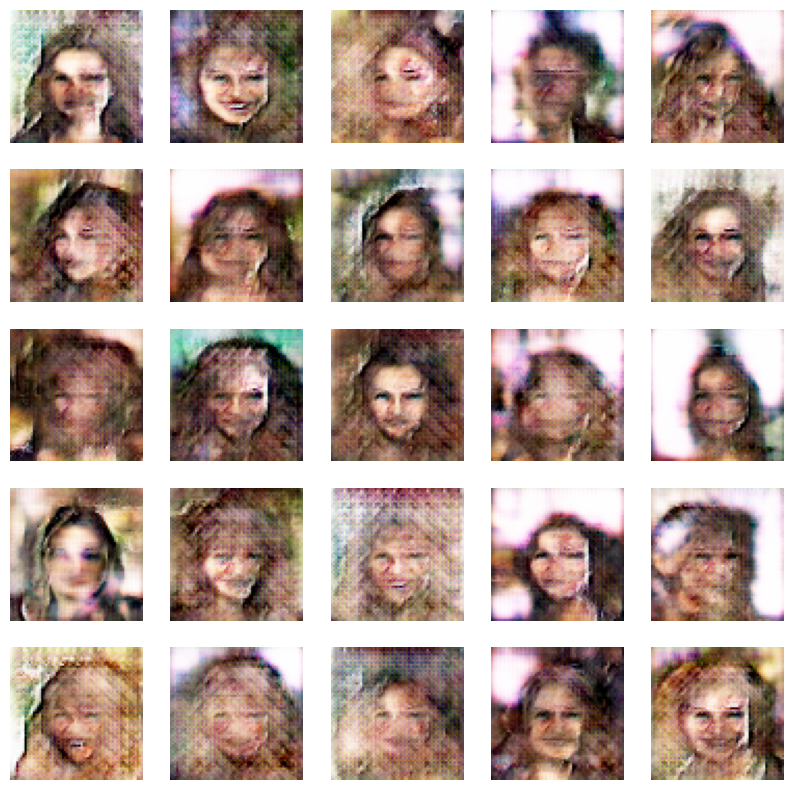

Epoch: 71/200
1/1 [==============================] - 0s 30ms/step
Epoch: 71,  Loss: D_real = 0.286, D_fake = 0.275,  G = 3.611
Epoch: 72/200
1/1 [==============================] - 0s 33ms/step
Epoch: 72,  Loss: D_real = 0.570, D_fake = 0.197,  G = 3.455
Epoch: 73/200
1/1 [==============================] - 0s 26ms/step
Epoch: 73,  Loss: D_real = 0.297, D_fake = 0.085,  G = 3.019
Epoch: 74/200
1/1 [==============================] - 0s 25ms/step
Epoch: 74,  Loss: D_real = 0.204, D_fake = 0.059,  G = 3.470
Epoch: 75/200
1/1 [==============================] - 0s 27ms/step
Epoch: 75,  Loss: D_real = 0.206, D_fake = 0.076,  G = 3.662
Epoch: 76/200
1/1 [==============================] - 0s 26ms/step
Epoch: 76,  Loss: D_real = 0.635, D_fake = 0.203,  G = 3.614
Epoch: 77/200
1/1 [==============================] - 0s 28ms/step
Epoch: 77,  Loss: D_real = 0.151, D_fake = 0.201,  G = 3.132
Epoch: 78/200
1/1 [==============================] - 0s 27ms/step
Epoch: 78,  Loss: D_real = 0.336, D_fake = 0.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


>Accuracy [real: 84%, fake: 97%]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

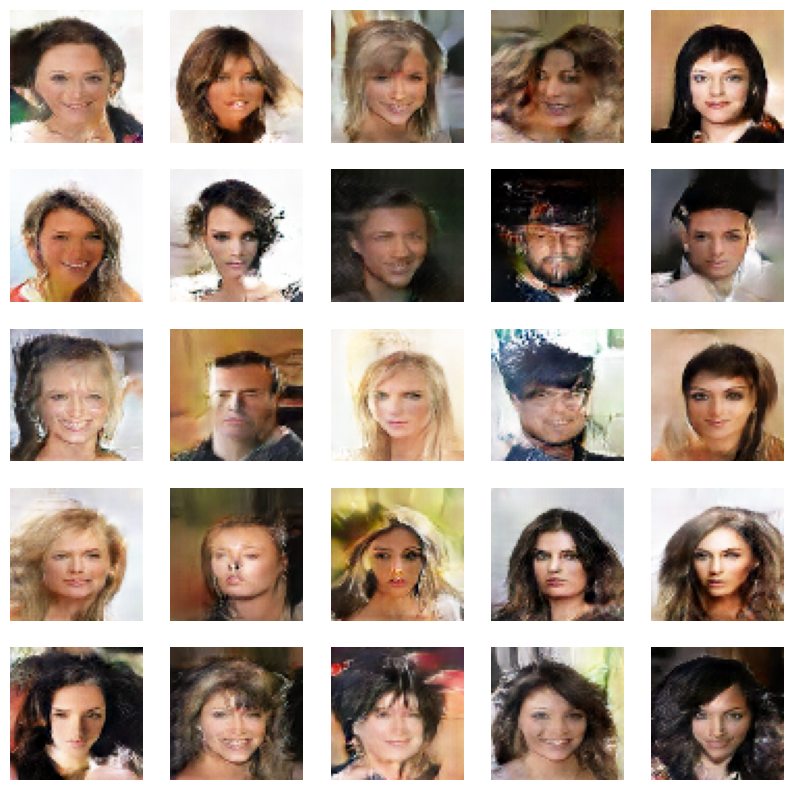

Epoch: 81/200
1/1 [==============================] - 0s 43ms/step
Epoch: 81,  Loss: D_real = 0.131, D_fake = 0.283,  G = 3.105
Epoch: 82/200
1/1 [==============================] - 0s 25ms/step
Epoch: 82,  Loss: D_real = 0.623, D_fake = 0.393,  G = 2.316
Epoch: 83/200
1/1 [==============================] - 0s 35ms/step
Epoch: 83,  Loss: D_real = 0.812, D_fake = 0.042,  G = 3.681
Epoch: 84/200
1/1 [==============================] - 0s 25ms/step
Epoch: 84,  Loss: D_real = 0.552, D_fake = 0.105,  G = 2.821
Epoch: 85/200
1/1 [==============================] - 0s 25ms/step
Epoch: 85,  Loss: D_real = 0.206, D_fake = 0.145,  G = 3.268
Epoch: 86/200
1/1 [==============================] - 0s 32ms/step
Epoch: 86,  Loss: D_real = 0.066, D_fake = 0.282,  G = 3.941
Epoch: 87/200
1/1 [==============================] - 0s 25ms/step
Epoch: 87,  Loss: D_real = 0.195, D_fake = 0.126,  G = 3.617
Epoch: 88/200
1/1 [==============================] - 0s 36ms/step
Epoch: 88,  Loss: D_real = 0.196, D_fake = 0.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


>Accuracy [real: 93%, fake: 100%]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

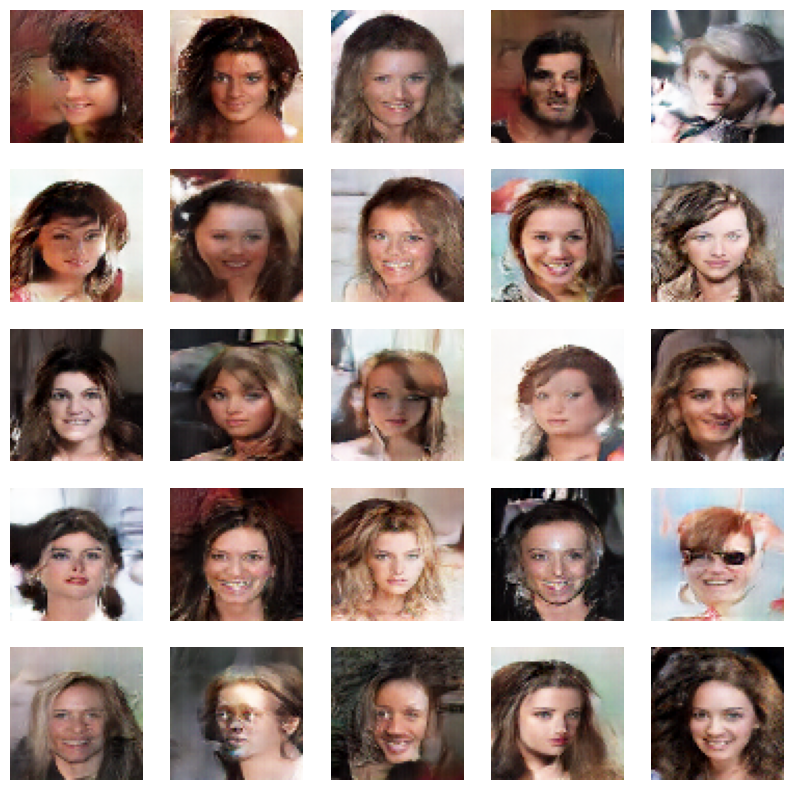

Epoch: 91/200
1/1 [==============================] - 0s 31ms/step
Epoch: 91,  Loss: D_real = 0.519, D_fake = 0.055,  G = 3.109
Epoch: 92/200
1/1 [==============================] - 0s 36ms/step


2023-10-26 08:07:37.692396: W tensorflow/core/data/root_dataset.cc:286] Optimization loop failed: CANCELLED: Operation was cancelled


1/1 [==============================] - 0s 32ms/step
Epoch: 92,  Loss: D_real = 0.440, D_fake = 0.174,  G = 3.556
Epoch: 93/200
1/1 [==============================] - 0s 45ms/step
Epoch: 93,  Loss: D_real = 0.111, D_fake = 0.040,  G = 4.124
Epoch: 94/200
1/1 [==============================] - 0s 34ms/step
Epoch: 94,  Loss: D_real = 0.210, D_fake = 0.047,  G = 2.741
Epoch: 95/200
1/1 [==============================] - 0s 26ms/step
Epoch: 95,  Loss: D_real = 0.031, D_fake = 0.097,  G = 3.888
Epoch: 96/200
1/1 [==============================] - 0s 33ms/step
Epoch: 96,  Loss: D_real = 0.430, D_fake = 0.418,  G = 4.257
Epoch: 97/200
1/1 [==============================] - 0s 33ms/step
Epoch: 97,  Loss: D_real = 0.062, D_fake = 0.039,  G = 4.121
Epoch: 98/200
1/1 [==============================] - 0s 38ms/step
Epoch: 98,  Loss: D_real = 0.011, D_fake = 0.272,  G = 3.650
Epoch: 99/200
1/1 [==============================] - 0s 39ms/step
Epoch: 99,  Loss: D_real = 0.148, D_fake = 0.031,  G = 3.76

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


>Accuracy [real: 96%, fake: 99%]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

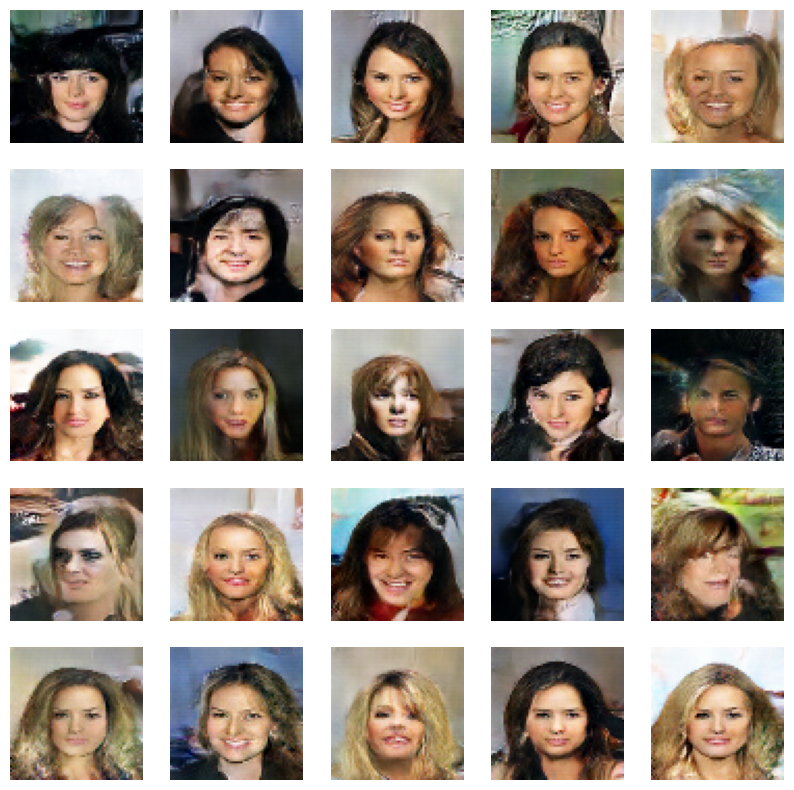

Epoch: 101/200
1/1 [==============================] - 0s 37ms/step


2023-10-26 08:23:30.154335: W tensorflow/core/data/root_dataset.cc:286] Optimization loop failed: CANCELLED: Operation was cancelled


1/1 [==============================] - 0s 38ms/step
Epoch: 101,  Loss: D_real = 0.117, D_fake = 0.126,  G = 3.013
Epoch: 102/200
1/1 [==============================] - 0s 40ms/step
Epoch: 102,  Loss: D_real = 0.281, D_fake = 0.101,  G = 4.292
Epoch: 103/200
1/1 [==============================] - 0s 34ms/step
Epoch: 103,  Loss: D_real = 0.265, D_fake = 0.119,  G = 3.832
Epoch: 104/200
1/1 [==============================] - 0s 34ms/step
Epoch: 104,  Loss: D_real = 0.095, D_fake = 0.325,  G = 3.380
Epoch: 105/200
1/1 [==============================] - 0s 43ms/step
Epoch: 105,  Loss: D_real = 0.257, D_fake = 0.157,  G = 4.647
Epoch: 106/200
1/1 [==============================] - 0s 90ms/step
Epoch: 106,  Loss: D_real = 0.128, D_fake = 0.262,  G = 4.980
Epoch: 107/200
1/1 [==============================] - 0s 56ms/step
Epoch: 107,  Loss: D_real = 0.058, D_fake = 0.095,  G = 4.711
Epoch: 108/200
1/1 [==============================] - 0s 31ms/step
Epoch: 108,  Loss: D_real = 0.166, D_fake = 0

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


>Accuracy [real: 96%, fake: 100%]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

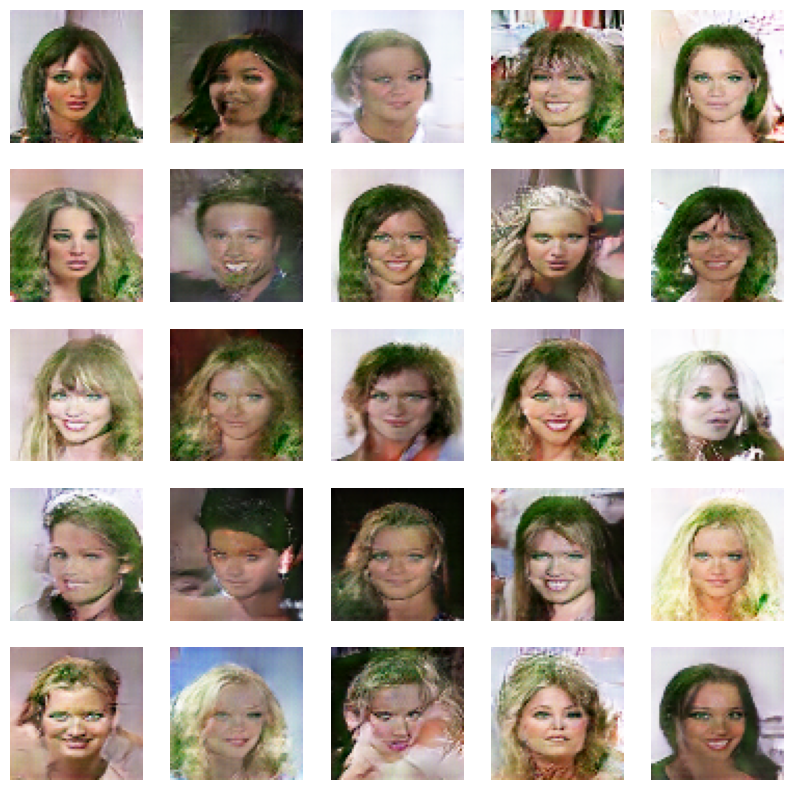

Epoch: 111/200
1/1 [==============================] - 0s 25ms/step
Epoch: 111,  Loss: D_real = 0.147, D_fake = 0.281,  G = 4.550
Epoch: 112/200
1/1 [==============================] - 0s 29ms/step
Epoch: 112,  Loss: D_real = 0.075, D_fake = 0.234,  G = 4.289
Epoch: 113/200
1/1 [==============================] - 0s 29ms/step
Epoch: 113,  Loss: D_real = 0.245, D_fake = 0.627,  G = 3.827
Epoch: 114/200
1/1 [==============================] - 0s 26ms/step
Epoch: 114,  Loss: D_real = 0.132, D_fake = 0.261,  G = 3.648
Epoch: 115/200
1/1 [==============================] - 0s 26ms/step
Epoch: 115,  Loss: D_real = 0.244, D_fake = 0.055,  G = 3.754
Epoch: 116/200
1/1 [==============================] - 0s 26ms/step
Epoch: 116,  Loss: D_real = 0.239, D_fake = 0.472,  G = 3.502
Epoch: 117/200
1/1 [==============================] - 0s 25ms/step
Epoch: 117,  Loss: D_real = 0.305, D_fake = 0.105,  G = 3.582
Epoch: 118/200
1/1 [==============================] - 0s 31ms/step
Epoch: 118,  Loss: D_real = 0.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


>Accuracy [real: 94%, fake: 100%]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

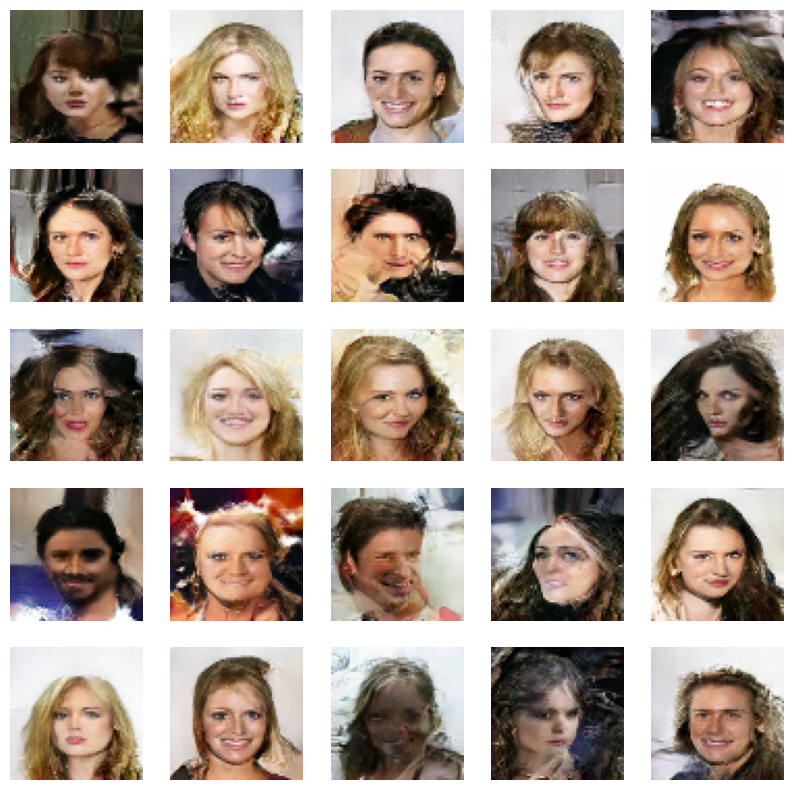

Epoch: 121/200
1/1 [==============================] - 0s 28ms/step
Epoch: 121,  Loss: D_real = 0.018, D_fake = 0.057,  G = 4.224
Epoch: 122/200
1/1 [==============================] - 0s 26ms/step
Epoch: 122,  Loss: D_real = 0.122, D_fake = 0.208,  G = 4.432
Epoch: 123/200
1/1 [==============================] - 0s 25ms/step
Epoch: 123,  Loss: D_real = 0.234, D_fake = 0.184,  G = 5.728
Epoch: 124/200
1/1 [==============================] - 0s 24ms/step
Epoch: 124,  Loss: D_real = 0.152, D_fake = 0.393,  G = 2.802
Epoch: 125/200
1/1 [==============================] - 0s 27ms/step
Epoch: 125,  Loss: D_real = 0.051, D_fake = 0.280,  G = 4.666
Epoch: 126/200
1/1 [==============================] - 0s 25ms/step
Epoch: 126,  Loss: D_real = 0.082, D_fake = 0.145,  G = 3.149
Epoch: 127/200
1/1 [==============================] - 0s 34ms/step
Epoch: 127,  Loss: D_real = 0.046, D_fake = 0.186,  G = 3.849
Epoch: 128/200
1/1 [==============================] - 0s 25ms/step
Epoch: 128,  Loss: D_real = 0.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


>Accuracy [real: 91%, fake: 98%]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

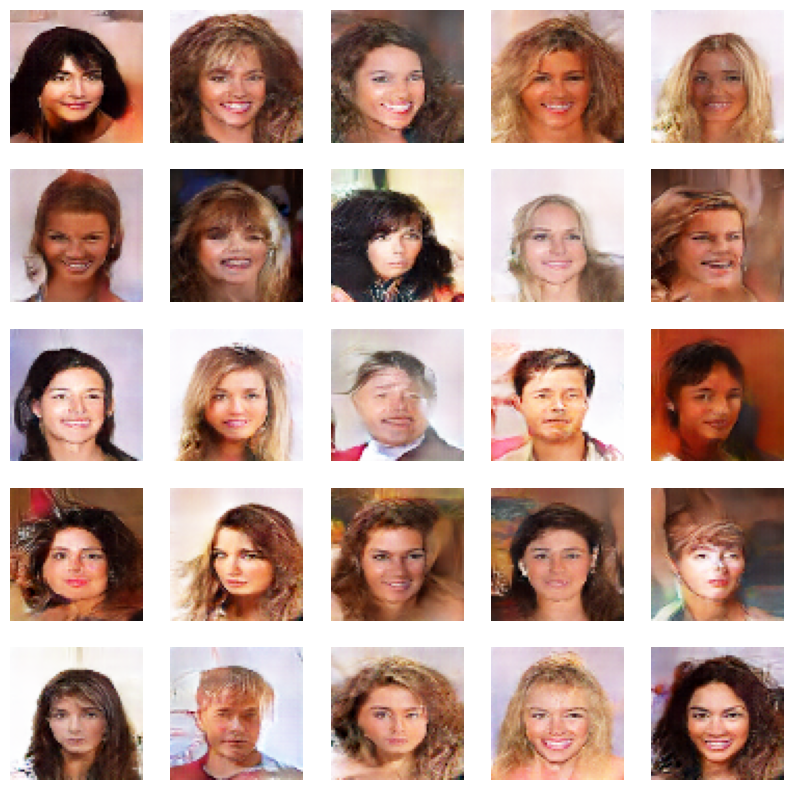

Epoch: 131/200
1/1 [==============================] - 0s 25ms/step
Epoch: 131,  Loss: D_real = 0.322, D_fake = 0.078,  G = 4.783
Epoch: 132/200
1/1 [==============================] - 0s 34ms/step
Epoch: 132,  Loss: D_real = 0.238, D_fake = 1.040,  G = 4.368
Epoch: 133/200
1/1 [==============================] - 0s 26ms/step
Epoch: 133,  Loss: D_real = 0.040, D_fake = 0.259,  G = 4.027
Epoch: 134/200
1/1 [==============================] - 0s 25ms/step
Epoch: 134,  Loss: D_real = 0.226, D_fake = 0.200,  G = 3.694
Epoch: 135/200
1/1 [==============================] - 0s 26ms/step
Epoch: 135,  Loss: D_real = 0.597, D_fake = 0.523,  G = 4.147
Epoch: 136/200
1/1 [==============================] - 0s 27ms/step
Epoch: 136,  Loss: D_real = 0.008, D_fake = 0.067,  G = 3.839
Epoch: 137/200
1/1 [==============================] - 0s 25ms/step
Epoch: 137,  Loss: D_real = 0.082, D_fake = 0.062,  G = 4.641
Epoch: 138/200
1/1 [==============================] - 0s 25ms/step
Epoch: 138,  Loss: D_real = 0.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


>Accuracy [real: 94%, fake: 98%]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

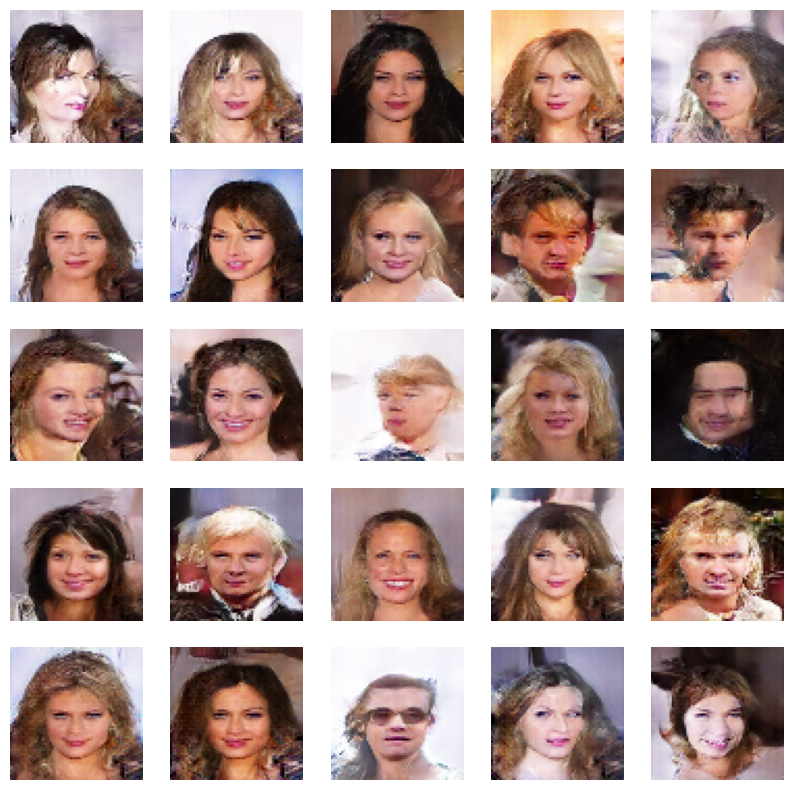

Epoch: 141/200
1/1 [==============================] - 0s 24ms/step
Epoch: 141,  Loss: D_real = 0.103, D_fake = 0.233,  G = 5.157
Epoch: 142/200
1/1 [==============================] - 0s 25ms/step
Epoch: 142,  Loss: D_real = 0.408, D_fake = 0.044,  G = 5.157
Epoch: 143/200
1/1 [==============================] - 0s 25ms/step
Epoch: 143,  Loss: D_real = 0.022, D_fake = 0.074,  G = 5.054
Epoch: 144/200
1/1 [==============================] - 0s 28ms/step
Epoch: 144,  Loss: D_real = 0.176, D_fake = 0.108,  G = 4.082
Epoch: 145/200
1/1 [==============================] - 0s 26ms/step
Epoch: 145,  Loss: D_real = 0.008, D_fake = 0.012,  G = 4.919
Epoch: 146/200
1/1 [==============================] - 0s 25ms/step
Epoch: 146,  Loss: D_real = 0.450, D_fake = 0.014,  G = 4.719
Epoch: 147/200
1/1 [==============================] - 0s 29ms/step
Epoch: 147,  Loss: D_real = 0.243, D_fake = 0.249,  G = 4.800
Epoch: 148/200
1/1 [==============================] - 0s 27ms/step
Epoch: 148,  Loss: D_real = 0.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


>Accuracy [real: 91%, fake: 98%]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

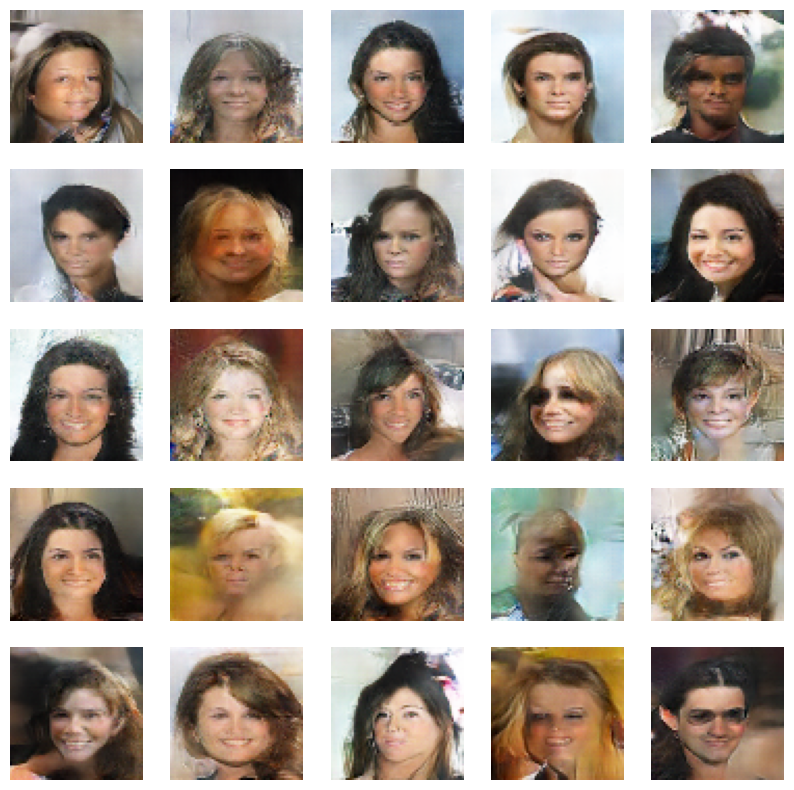

Epoch: 151/200
1/1 [==============================] - 0s 26ms/step
Epoch: 151,  Loss: D_real = 0.008, D_fake = 0.068,  G = 5.382
Epoch: 152/200
1/1 [==============================] - 0s 25ms/step
Epoch: 152,  Loss: D_real = 0.066, D_fake = 0.254,  G = 6.425
Epoch: 153/200
1/1 [==============================] - 0s 38ms/step
Epoch: 153,  Loss: D_real = 0.302, D_fake = 0.009,  G = 5.540
Epoch: 154/200
1/1 [==============================] - 0s 25ms/step
Epoch: 154,  Loss: D_real = 0.034, D_fake = 0.391,  G = 4.877
Epoch: 155/200
1/1 [==============================] - 0s 25ms/step
Epoch: 155,  Loss: D_real = 0.382, D_fake = 0.215,  G = 2.857
Epoch: 156/200
1/1 [==============================] - 0s 26ms/step
Epoch: 156,  Loss: D_real = 0.313, D_fake = 0.180,  G = 3.763
Epoch: 157/200
1/1 [==============================] - 0s 27ms/step
Epoch: 157,  Loss: D_real = 0.040, D_fake = 0.054,  G = 5.248
Epoch: 158/200
1/1 [==============================] - 0s 26ms/step
Epoch: 158,  Loss: D_real = 0.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


>Accuracy [real: 99%, fake: 94%]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

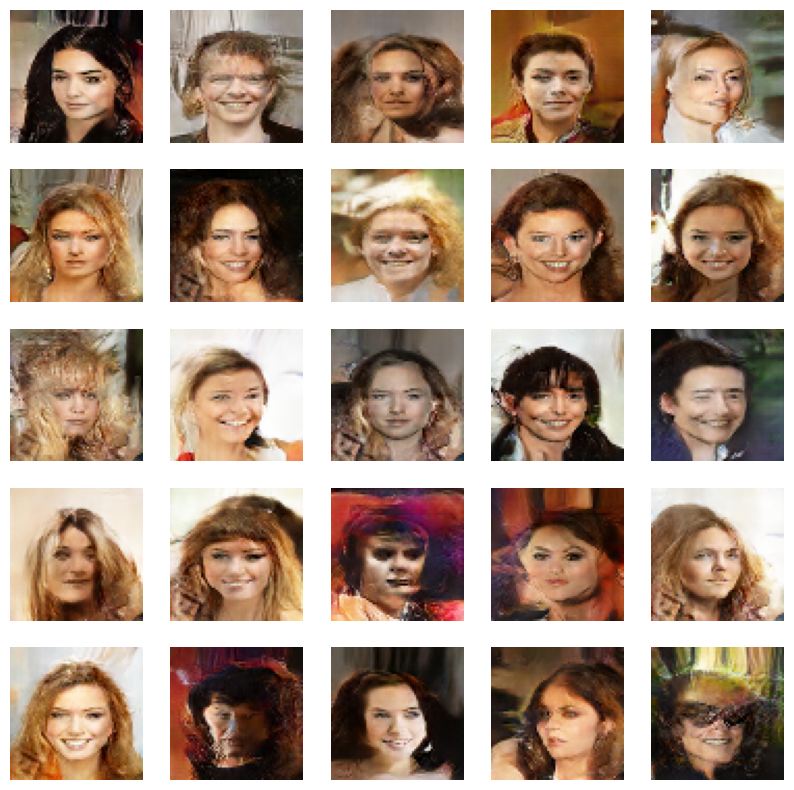

Epoch: 161/200
1/1 [==============================] - 0s 25ms/step
Epoch: 161,  Loss: D_real = 0.020, D_fake = 0.039,  G = 4.163
Epoch: 162/200
1/1 [==============================] - 0s 25ms/step
Epoch: 162,  Loss: D_real = 0.102, D_fake = 0.069,  G = 3.652
Epoch: 163/200
1/1 [==============================] - 0s 25ms/step
Epoch: 163,  Loss: D_real = 0.235, D_fake = 0.032,  G = 4.107
Epoch: 164/200
1/1 [==============================] - 0s 25ms/step
Epoch: 164,  Loss: D_real = 0.131, D_fake = 0.151,  G = 4.572
Epoch: 165/200
1/1 [==============================] - 0s 25ms/step
Epoch: 165,  Loss: D_real = 0.042, D_fake = 0.031,  G = 6.017
Epoch: 166/200
1/1 [==============================] - 0s 26ms/step
Epoch: 166,  Loss: D_real = 0.119, D_fake = 0.052,  G = 5.187
Epoch: 167/200
1/1 [==============================] - 0s 25ms/step
Epoch: 167,  Loss: D_real = 0.051, D_fake = 0.016,  G = 5.342
Epoch: 168/200
1/1 [==============================] - 0s 26ms/step
Epoch: 168,  Loss: D_real = 0.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


>Accuracy [real: 98%, fake: 96%]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

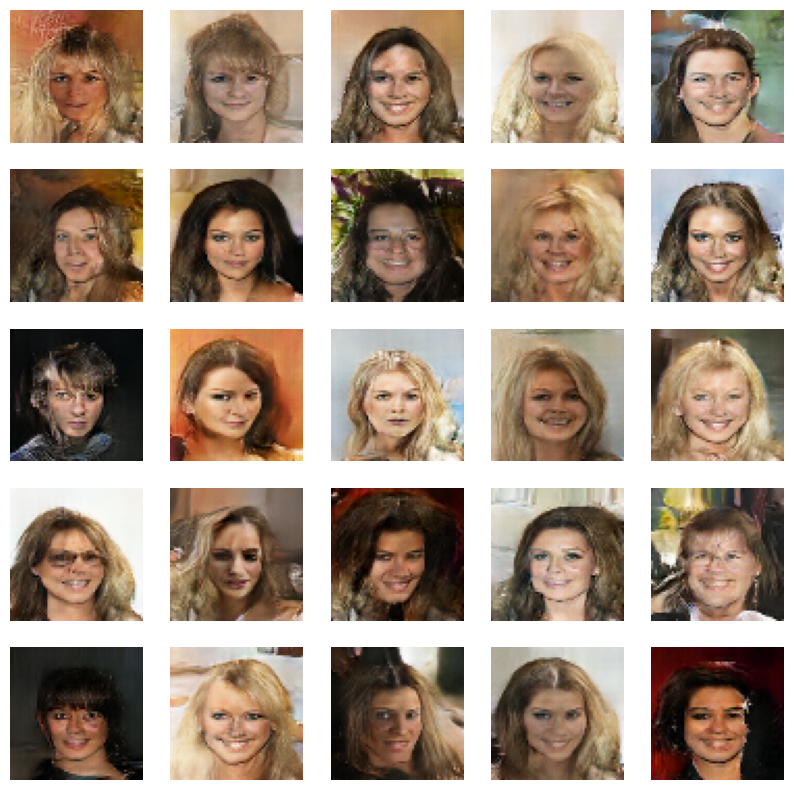

Epoch: 171/200
1/1 [==============================] - 0s 25ms/step
Epoch: 171,  Loss: D_real = 0.192, D_fake = 0.012,  G = 4.837
Epoch: 172/200
1/1 [==============================] - 0s 25ms/step
Epoch: 172,  Loss: D_real = 0.447, D_fake = 0.493,  G = 5.525
Epoch: 173/200
1/1 [==============================] - 0s 25ms/step
Epoch: 173,  Loss: D_real = 0.016, D_fake = 0.029,  G = 5.857
Epoch: 174/200
1/1 [==============================] - 0s 26ms/step
Epoch: 174,  Loss: D_real = 0.098, D_fake = 0.067,  G = 5.056
Epoch: 175/200
1/1 [==============================] - 0s 26ms/step
Epoch: 175,  Loss: D_real = 0.500, D_fake = 0.072,  G = 3.176
Epoch: 176/200
1/1 [==============================] - 0s 27ms/step
Epoch: 176,  Loss: D_real = 0.062, D_fake = 0.322,  G = 5.239
Epoch: 177/200
1/1 [==============================] - 0s 35ms/step
Epoch: 177,  Loss: D_real = 0.696, D_fake = 0.217,  G = 4.416
Epoch: 178/200
1/1 [==============================] - 0s 26ms/step
Epoch: 178,  Loss: D_real = 0.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


>Accuracy [real: 96%, fake: 99%]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

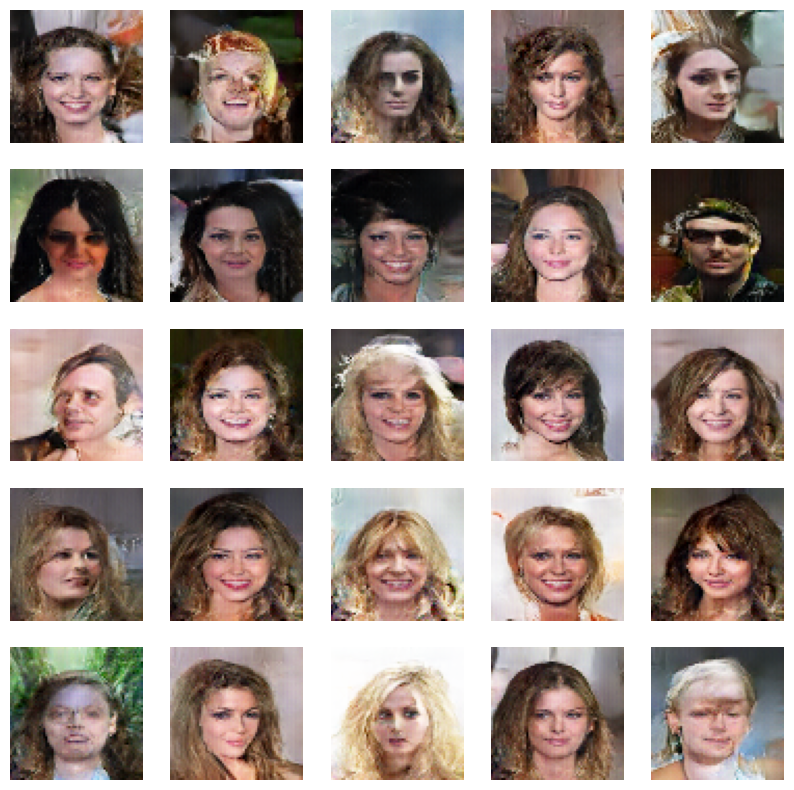

Epoch: 181/200
1/1 [==============================] - 0s 25ms/step
Epoch: 181,  Loss: D_real = 0.293, D_fake = 0.076,  G = 4.475
Epoch: 182/200
1/1 [==============================] - 0s 24ms/step
Epoch: 182,  Loss: D_real = 0.330, D_fake = 0.058,  G = 4.880
Epoch: 183/200
1/1 [==============================] - 0s 34ms/step
Epoch: 183,  Loss: D_real = 0.162, D_fake = 0.209,  G = 5.163
Epoch: 184/200
1/1 [==============================] - 0s 27ms/step
Epoch: 184,  Loss: D_real = 0.233, D_fake = 0.061,  G = 5.341
Epoch: 185/200
1/1 [==============================] - 0s 26ms/step
Epoch: 185,  Loss: D_real = 0.382, D_fake = 0.050,  G = 5.032
Epoch: 186/200
1/1 [==============================] - 0s 26ms/step
Epoch: 186,  Loss: D_real = 1.709, D_fake = 1.738,  G = 3.631
Epoch: 187/200
1/1 [==============================] - 0s 26ms/step
Epoch: 187,  Loss: D_real = 0.081, D_fake = 0.150,  G = 4.273
Epoch: 188/200
1/1 [==============================] - 0s 25ms/step
Epoch: 188,  Loss: D_real = 0.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


>Accuracy [real: 94%, fake: 99%]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

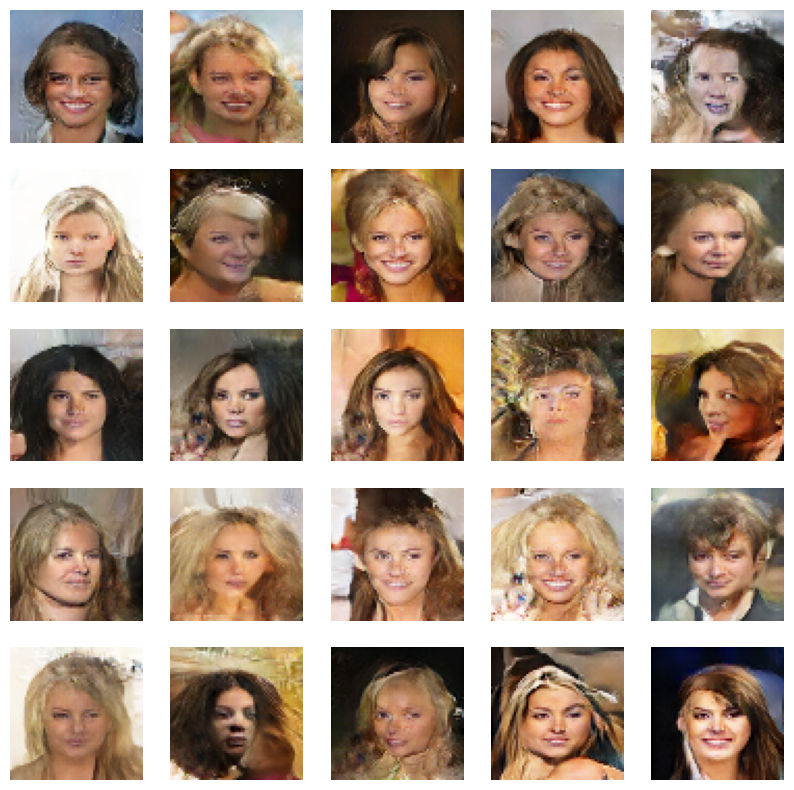

Epoch: 191/200
1/1 [==============================] - 0s 26ms/step
Epoch: 191,  Loss: D_real = 0.202, D_fake = 0.156,  G = 4.862
Epoch: 192/200
1/1 [==============================] - 0s 33ms/step
Epoch: 192,  Loss: D_real = 0.123, D_fake = 0.192,  G = 5.990
Epoch: 193/200
1/1 [==============================] - 0s 27ms/step
Epoch: 193,  Loss: D_real = 0.075, D_fake = 0.306,  G = 5.650
Epoch: 194/200
1/1 [==============================] - 0s 26ms/step
Epoch: 194,  Loss: D_real = 0.285, D_fake = 0.052,  G = 5.148
Epoch: 195/200
1/1 [==============================] - 0s 25ms/step
Epoch: 195,  Loss: D_real = 0.524, D_fake = 0.013,  G = 4.262
Epoch: 196/200
1/1 [==============================] - 0s 32ms/step
Epoch: 196,  Loss: D_real = 0.004, D_fake = 0.206,  G = 5.932
Epoch: 197/200
1/1 [==============================] - 0s 26ms/step
Epoch: 197,  Loss: D_real = 0.535, D_fake = 0.016,  G = 7.026
Epoch: 198/200
1/1 [==============================] - 0s 25ms/step
Epoch: 198,  Loss: D_real = 0.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


>Accuracy [real: 94%, fake: 99%]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

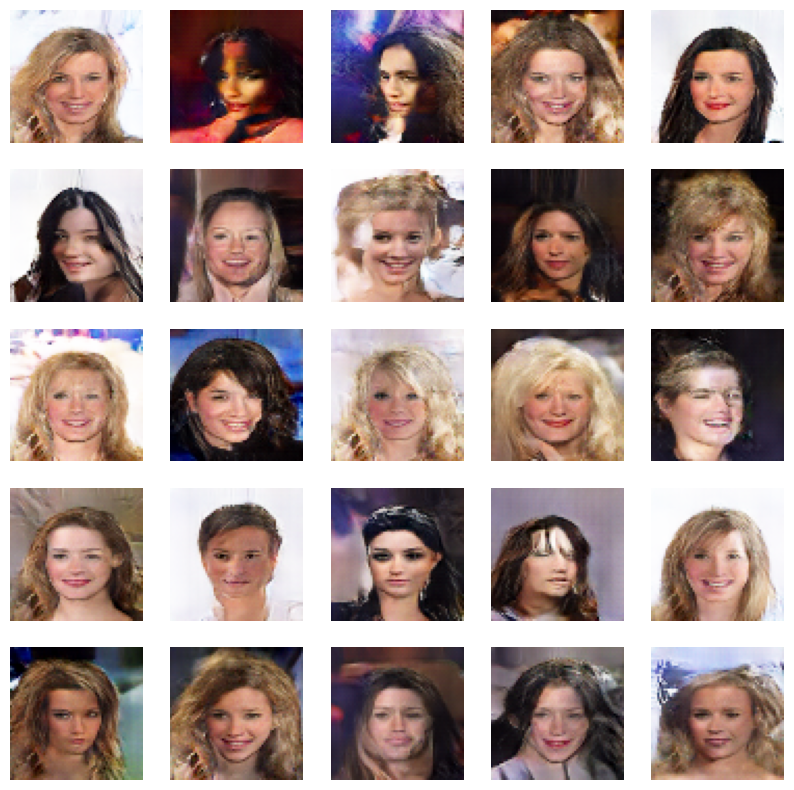

Total time for training 200 epochs is 20793.392362356186 sec


In [18]:
n_epoch = 200
train(gen, dis, GAN, images, latent_dim, n_epoch)

In [19]:
GAN.save("dcgan_model.h5")

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# ! mkdir outputDCGAN

In [ ]:
# files = []
# n_iter = int(n_epoch / 10 -1)
# for e in range(n_iter):
#     img_name = '/work/assignment/a3_gan/abijith/outputDCGAN{:04d}.png'.format((e+1)*10)
#     files.append(imageio.imread(img_name))
# imageio.mimsave('dcgan_celebA_generation_animation.gif', files, fps=5)